<a href="https://colab.research.google.com/github/loni9164/Real-Estate/blob/master/model_interpretation_Reg.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Try out below Explainability techniques on regression algorithms
1. Shap
2. Lime
3. Shapash
4. InterpretML

# Import/Install libraries

In [7]:
import pandas as pd
import seaborn as sns
import numpy as np
#from google.colab import drive
!pip install sklearn
from sklearn import datasets
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression, LinearRegression
from sklearn.ensemble import RandomForestClassifier,RandomForestRegressor
from sklearn import svm
from sklearn.preprocessing import LabelEncoder
import xgboost
import lightgbm as lgb
!pip install catboost 
from catboost import CatBoostClassifier,CatBoostRegressor
from sklearn.metrics import accuracy_score,mean_absolute_error,r2_score
from sklearn.preprocessing import StandardScaler
from sklearn import svm
import matplotlib.pyplot as plt

#Shap
!pip install shap
import shap

#Lime
!pip install lime
import lime
from lime import lime_tabular

#Shapash
!pip install shapash
from shapash import SmartExplainer

#InterpretML
!pip install interpret
from interpret import set_visualize_provider
from interpret.provider import InlineProvider
set_visualize_provider(InlineProvider())
from interpret import show
from interpret.blackbox import ShapKernel,LimeTabular,PartialDependence,MorrisSensitivity

!pip install WitWidget
from witwidget.notebook.visualization import WitConfigBuilder
from witwidget.notebook.visualization import WitWidget


Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


# Dataset

In [1]:
data_path='https://raw.githubusercontent.com/loni9164/explainable_ai/main/forestfires.csv'

In [4]:
data=pd.read_csv(data_path)

In [5]:
data.head()

,X,Y,month,day,FFMC,DMC,DC,ISI,temp,RH,wind,rain,area
0,7,5,mar,fri,86.2,26.2,94.3,5.1,8.2,51,6.7,0.0,0.0
1,7,4,oct,tue,90.6,35.4,669.1,6.7,18.0,33,0.9,0.0,0.0
2,7,4,oct,sat,90.6,43.7,686.9,6.7,14.6,33,1.3,0.0,0.0
3,8,6,mar,fri,91.7,33.3,77.5,9.0,8.3,97,4.0,0.2,0.0
4,8,6,mar,sun,89.3,51.3,102.2,9.6,11.4,99,1.8,0.0,0.0


In [23]:
label_encoder=LabelEncoder()

In [24]:
data['month']=label_encoder.fit_transform((data['month']))
data['day']=label_encoder.fit_transform((data['day']))

In [27]:
X=data.drop('area',axis=1)

In [32]:
y=data[['area']]

In [35]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2)

# Regression models

## Linear Regression

In [36]:
lr_reg=LinearRegression()
lr_reg.fit(X_train,np.array(y_train).flatten())
y_pred=lr_reg.predict(X_test)
r2_score(y_pred,y_test)

-3.3787880321810793

## Random Forest Regressor

In [37]:
rf_reg=RandomForestRegressor()
rf_reg.fit(X_train,y_train)
y_pred=rf_reg.predict(X_test)
r2_score(y_pred,y_test)

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: DataConversionWarning:

A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().



-3.7994525897196105

## Support Vector Regressor

In [38]:
svr_reg = svm.SVR()
svr_reg.fit(X_train,y_train)
y_pred=svr_reg.predict(X_test)
r2_score(y_pred,y_test)

/usr/local/lib/python3.7/dist-packages/sklearn/utils/validation.py:993: DataConversionWarning:

A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().



-11707.12037877234

## Xgboost Regressor

In [39]:
xgb_reg = xgboost.XGBRegressor()
xgb_reg.fit(X_train.values, y_train.values)
y_pred=xgb_reg.predict(X_test.values)
r2_score(y_pred,y_test)

[09:50:41] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.


-0.9238303744215002

## Light GBM Regressor

In [40]:
lgb_reg=lgb.LGBMRegressor()
lgb_reg.fit(X_train,y_train)
y_pred=lgb_reg.predict(X_test)
r2_score(y_pred,y_test)

-1.3347694351877841

## CatBoost Regressor

In [41]:
cat_reg = CatBoostRegressor()
cat_reg.fit(X_train,y_train)
y_pred=cat_reg.predict(X_test)
r2_score(y_pred,y_test)

Learning rate set to 0.035604
0:	learn: 69.4006084	total: 47.7ms	remaining: 47.6s
1:	learn: 68.8835385	total: 49.1ms	remaining: 24.5s
2:	learn: 68.3057908	total: 50.4ms	remaining: 16.8s
3:	learn: 67.8482672	total: 52.9ms	remaining: 13.2s
4:	learn: 67.3448263	total: 54.6ms	remaining: 10.9s
5:	learn: 66.8757798	total: 57.6ms	remaining: 9.55s
6:	learn: 66.3557515	total: 59.1ms	remaining: 8.39s
7:	learn: 65.5676545	total: 60.5ms	remaining: 7.5s
8:	learn: 65.2058730	total: 61.6ms	remaining: 6.79s
9:	learn: 64.8013319	total: 62.8ms	remaining: 6.21s
10:	learn: 64.4539190	total: 63.9ms	remaining: 5.75s
11:	learn: 64.0240149	total: 65.1ms	remaining: 5.36s
12:	learn: 63.8467164	total: 66.3ms	remaining: 5.03s
13:	learn: 63.5095297	total: 67.5ms	remaining: 4.75s
14:	learn: 63.0348778	total: 68.8ms	remaining: 4.52s
15:	learn: 62.5490763	total: 70ms	remaining: 4.3s
16:	learn: 62.0831249	total: 71.1ms	remaining: 4.11s
17:	learn: 61.7630747	total: 72.5ms	remaining: 3.96s
18:	learn: 61.3038755	total: 7

-0.9662549098831508

### All Regression algorithms

In [42]:
regression_models=[lr_reg,svr_reg,rf_reg,xgb_reg,lgb_reg,cat_reg]
regression_models_tree=[rf_reg,xgb_reg,lgb_reg,cat_reg]

# Parameters for explainer

In [43]:
model=rf_reg
type_of_task='regression' #['classification', 'regression']
explainer_type='tree' #['linear','tree','kernel']
type_of_explaination='' #['local','global']
explainer_set=X_train
global_explaination_set=X_test
local_explaination_instance=5
probality_wrt_class=1
feature_names=X.columns

#InterpretML
X_dataset=X_test[:2]
y_dataset=y_test[:2]

# Shap

In [44]:
def shap_explainer(model,type_of_task,type_of_explaination,explainer_type,explainer_set,global_explaination_set,
                   local_explaination_instance,probality_wrt_class,feature_names):
    shap.initjs()
        #1--------------linear--------------------------
    if explainer_type=='linear':
        masker = shap.maskers.Independent(data=explainer_set)
        explainer = shap.LinearExplainer(model, masker = masker, feature_names=feature_names)
   
    #2--------------Tree--------------------------
    elif explainer_type=='tree':
        explainer = shap.TreeExplainer(model)
        
    #3--------------kernel--------------------------
    elif explainer_type=='kernel':
        if type_of_task == 'regression':
            model_fn=model.predict
        elif type_of_task == 'classification':
            model_fn=model.predict_proba 
        else:
            print('please check-type_of_task')
        explainer_summary=shap.kmeans(explainer_set,10)
        explainer = shap.KernelExplainer(model_fn, explainer_summary)
    else:
        print('please check-explainer_type')
        
     #4--------------shap_vales--------------------------

    shap_values = explainer.shap_values(global_explaination_set)
    
     #5--------------charts--------------------------
    if type_of_explaination=='global':
        shap.summary_plot(shap_values, global_explaination_set, feature_names=feature_names)
        
    elif type_of_explaination=='local':
        try:
            shap.force_plot(base_value=explainer.expected_value[probality_wrt_class],shap_values=shap_values[probality_wrt_class][local_explaination_instance],features=global_explaination_set.iloc[local_explaination_instance],matplotlib=True)
        except:
            shap.force_plot(base_value=explainer.expected_value,shap_values=shap_values[local_explaination_instance],features=global_explaination_set.iloc[local_explaination_instance],matplotlib=True)  
    else:
        print('please check-type_of_explaination')

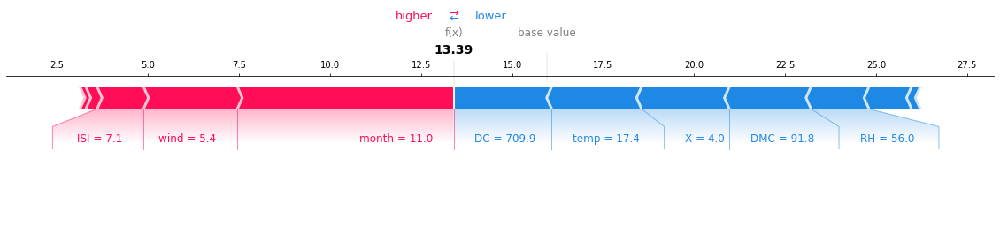

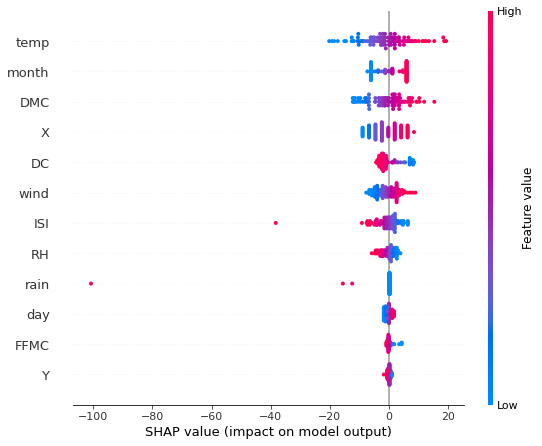

In [45]:
model=lr_reg
type_of_task='regression' #['classification', 'regression']
explainer_type='linear' #['linear','tree','kernel']
#type_of_explaination='local' #['local','global']
explainer_set=X_train
global_explaination_set=X_test
local_explaination_instance=5
probality_wrt_class=1
feature_names=X.columns

#InterpretML
X_dataset=X_test[:2] #2D array
y_dataset=y_test[:2] #2D array

type_of_explaination=['local','global']

for type_of_expl in type_of_explaination:
    shap_explainer(model,type_of_task,type_of_expl,explainer_type,explainer_set,global_explaination_set,
                   local_explaination_instance,probality_wrt_class,feature_names)

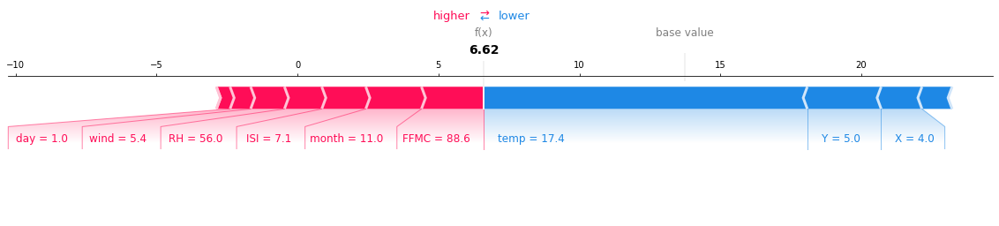

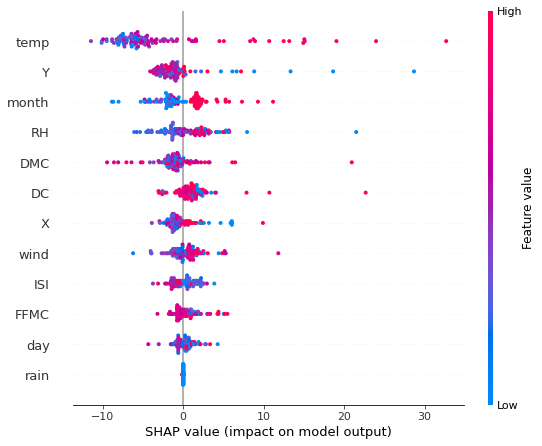

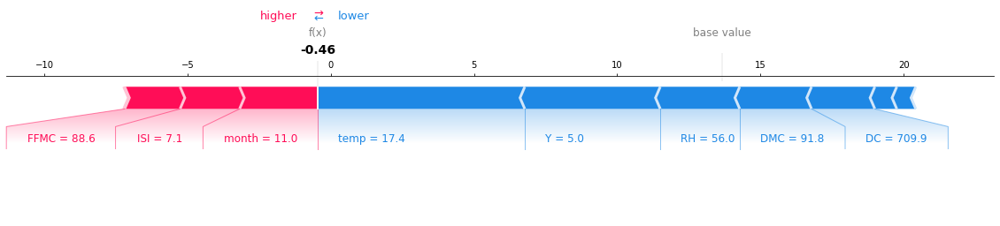

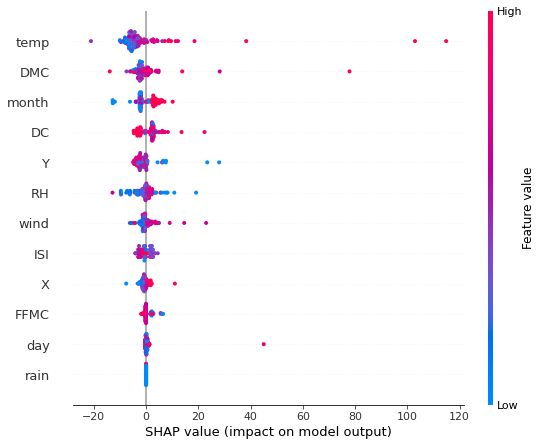

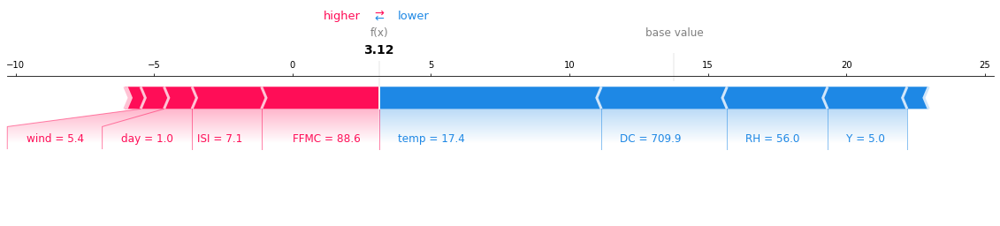

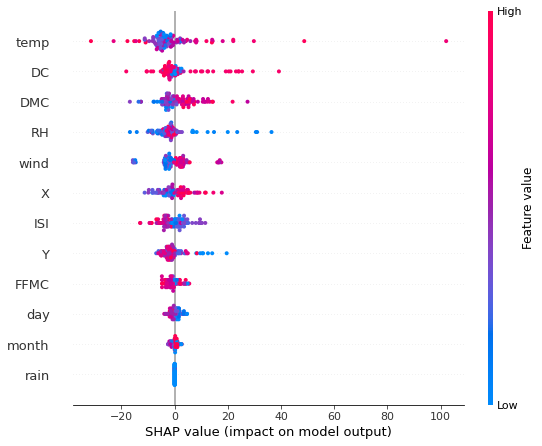

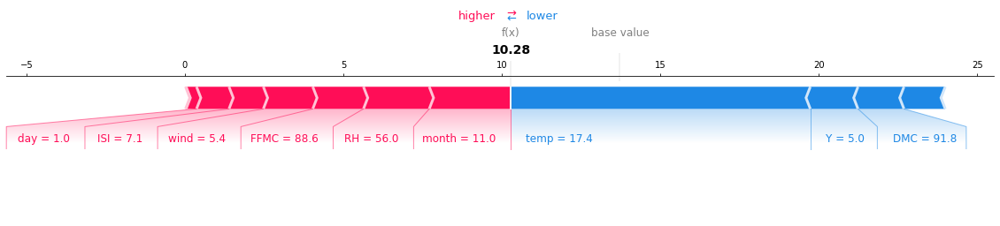

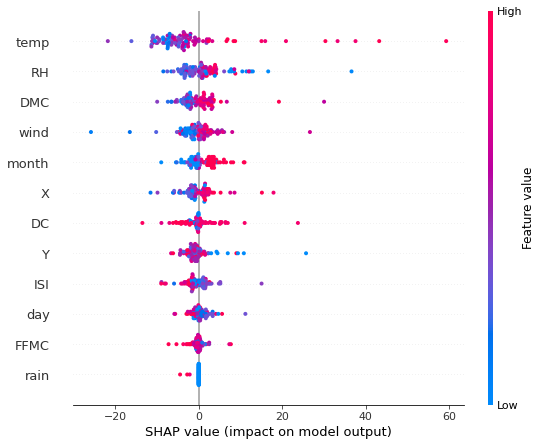

In [46]:
#model=rf_reg
type_of_task='regression' #['classification', 'regression']
explainer_type='tree' #['linear','tree','kernel']
#type_of_explaination='local' #['local','global']
explainer_set=X_train
global_explaination_set=X_test
local_explaination_instance=5
probality_wrt_class=1
feature_names=X.columns

#InterpretML
X_dataset=X_test[:2] #2D array
y_dataset=y_test[:2] #2D array

type_of_explaination=['local','global']

for model in regression_models_tree:
    for type_of_expl in type_of_explaination:
        shap_explainer(model,type_of_task,type_of_expl,explainer_type,explainer_set,global_explaination_set,
                       local_explaination_instance,probality_wrt_class,feature_names)

/usr/local/lib/python3.7/dist-packages/sklearn/base.py:451: UserWarning:

X does not have valid feature names, but SVR was fitted with feature names



  0%|          | 0/104 [00:00<?, ?it/s]

/usr/local/lib/python3.7/dist-packages/sklearn/base.py:451: UserWarning:

X does not have valid feature names, but SVR was fitted with feature names

INFO:shap:num_full_subsets = 5
/usr/local/lib/python3.7/dist-packages/sklearn/base.py:451: UserWarning:

X does not have valid feature names, but SVR was fitted with feature names

INFO:shap:phi = [ 5.73669111e-04 -2.39607285e-04  5.63117938e-04 -1.00464818e-04
 -4.85481199e-05 -3.82336390e-02  1.29130680e-01  2.47088971e-05
 -8.83061139e-04  2.63119746e-02  1.30412437e-05]
/usr/local/lib/python3.7/dist-packages/sklearn/base.py:451: UserWarning:

X does not have valid feature names, but SVR was fitted with feature names

INFO:shap:num_full_subsets = 5
/usr/local/lib/python3.7/dist-packages/sklearn/base.py:451: UserWarning:

X does not have valid feature names, but SVR was fitted with feature names

INFO:shap:phi = [-1.50692243e-04 -2.41867873e-04 -7.90619787e-04  3.44775649e-04
  1.67403952e-03 -3.74512146e-03  1.51231463e-01 -1.47027214e

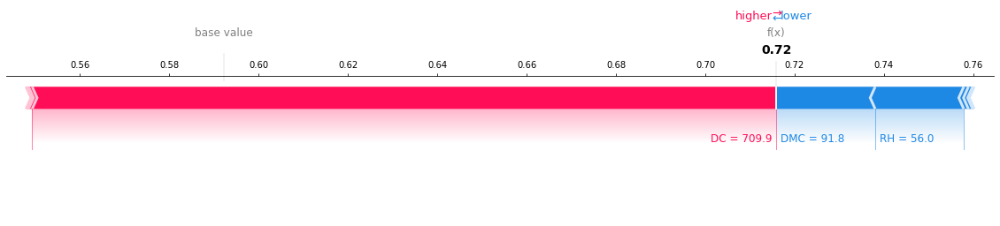

/usr/local/lib/python3.7/dist-packages/sklearn/base.py:451: UserWarning:

X does not have valid feature names, but SVR was fitted with feature names



  0%|          | 0/104 [00:00<?, ?it/s]

/usr/local/lib/python3.7/dist-packages/sklearn/base.py:451: UserWarning:

X does not have valid feature names, but SVR was fitted with feature names

INFO:shap:num_full_subsets = 5
/usr/local/lib/python3.7/dist-packages/sklearn/base.py:451: UserWarning:

X does not have valid feature names, but SVR was fitted with feature names

INFO:shap:phi = [ 5.73669111e-04 -2.39607285e-04  5.63117938e-04 -1.00464818e-04
 -4.85481199e-05 -3.82336390e-02  1.29130680e-01  2.47088971e-05
 -8.83061139e-04  2.63119746e-02  1.30412437e-05]
/usr/local/lib/python3.7/dist-packages/sklearn/base.py:451: UserWarning:

X does not have valid feature names, but SVR was fitted with feature names

INFO:shap:num_full_subsets = 5
/usr/local/lib/python3.7/dist-packages/sklearn/base.py:451: UserWarning:

X does not have valid feature names, but SVR was fitted with feature names

INFO:shap:phi = [-1.50692243e-04 -2.41867873e-04 -7.90619787e-04  3.44775649e-04
  1.67403952e-03 -3.74512146e-03  1.51231463e-01 -1.47027214e

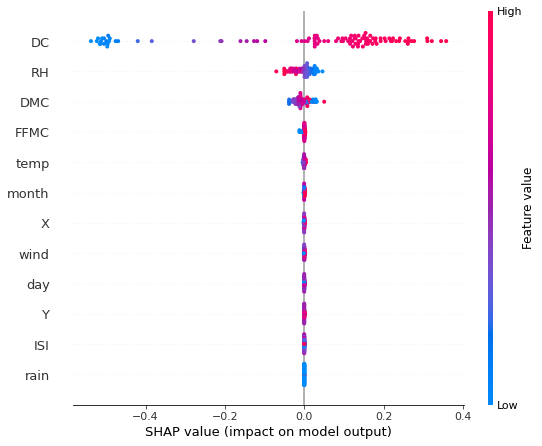

In [47]:
model=svr_reg
type_of_task='regression' #['classification', 'regression']
explainer_type='kernel' #['linear','tree','kernel']
#type_of_explaination='local' #['local','global']
explainer_set=X_train
global_explaination_set=X_test
local_explaination_instance=5
probality_wrt_class=1
feature_names=X.columns

#InterpretML
X_dataset=X_test[:2] #2D array
y_dataset=y_test[:2] #2D array

type_of_explaination=['local','global']

for type_of_expl in type_of_explaination:
    shap_explainer(model,type_of_task,type_of_expl,explainer_type,explainer_set,global_explaination_set,
                   local_explaination_instance,probality_wrt_class,feature_names)

# Lime

In [48]:
def lime_explainer(model,type_of_task, explainer_set,global_explaination_set,local_explaination_instance,feature_names):
    if type_of_task=='regression':
        predict_fn=model.predict
    if type_of_task=='classification':
        predict_fn=model.predict_proba
        
    explainer = lime_tabular.LimeTabularExplainer(training_data=np.array(explainer_set),
                                                  mode=type_of_task,
                                                  feature_names=feature_names,
                                                  verbose=True)

    exp = explainer.explain_instance(data_row=global_explaination_set.iloc[local_explaination_instance],predict_fn=predict_fn)
    exp.show_in_notebook(show_table=True)
    print(exp.as_list())

In [49]:
for model in regression_models:
    lime_explainer(model,type_of_task, explainer_set,global_explaination_set,local_explaination_instance,feature_names)

Intercept 1.1875230480347465
Prediction_local [15.32007]
Right: 13.394110085581717


/usr/local/lib/python3.7/dist-packages/sklearn/base.py:451: UserWarning:

X does not have valid feature names, but LinearRegression was fitted with feature names



[('5.00 < month <= 11.00', 9.183347210694052), ('rain <= 0.00', 8.897213096849026), ('wind > 4.90', 8.015409675095583), ('RH > 53.00', -4.177665037664212), ('61.10 < DMC <= 108.30', -3.8373808434289094), ('658.20 < DC <= 714.30', -2.677610121098726), ('15.80 < temp <= 19.40', -2.636766971488323), ('day <= 1.00', -1.9015738201668129), ('FFMC <= 90.30', 1.7086138647316955), ('6.50 < ISI <= 8.40', 1.5589599008184956)]
Intercept 0.5411327292820205
Prediction_local [0.68096071]
Right: 0.7158661266455086


/usr/local/lib/python3.7/dist-packages/sklearn/base.py:451: UserWarning:

X does not have valid feature names, but SVR was fitted with feature names



[('658.20 < DC <= 714.30', 0.1982977696177436), ('RH > 53.00', -0.04560022418097715), ('6.50 < ISI <= 8.40', -0.020192364878129646), ('rain <= 0.00', -0.01433193662435322), ('4.00 < Y <= 5.00', 0.013413332294043036), ('wind > 4.90', 0.012941280003984696), ('61.10 < DMC <= 108.30', 0.007407387430467295), ('5.00 < month <= 11.00', -0.00476805552142412), ('15.80 < temp <= 19.40', -0.003992689590988836), ('FFMC <= 90.30', -0.0033465168266806587)]
Intercept 25.965655042089278
Prediction_local [21.95050163]
Right: 6.615633333333334


/usr/local/lib/python3.7/dist-packages/sklearn/base.py:451: UserWarning:

X does not have valid feature names, but RandomForestRegressor was fitted with feature names



[('15.80 < temp <= 19.40', -15.298655573232036), ('RH > 53.00', 7.364862932743834), ('61.10 < DMC <= 108.30', -5.774636690844932), ('wind > 4.90', 5.193237463147954), ('FFMC <= 90.30', 4.851480129957691), ('4.00 < Y <= 5.00', -4.800012760546264), ('3.00 < X <= 4.00', 3.7255515113680167), ('658.20 < DC <= 714.30', -3.127168862299968), ('5.00 < month <= 11.00', 2.251947699849427), ('rain <= 0.00', 1.5982407330636748)]
Intercept 16.85932176571535
Prediction_local [28.75492648]
Right: -0.4612149


[('15.80 < temp <= 19.40', -15.509594433202798), ('RH > 53.00', 11.226446508218844), ('5.00 < month <= 11.00', 9.521418361686655), ('6.50 < ISI <= 8.40', 8.12723625926531), ('4.00 < Y <= 5.00', -7.056762629176761), ('FFMC <= 90.30', 4.250297459591987), ('61.10 < DMC <= 108.30', -4.0273358760354006), ('rain <= 0.00', 3.4161012590428848), ('3.00 < X <= 4.00', 2.8352755689307134), ('658.20 < DC <= 714.30', -0.8874777637209673)]
Intercept 17.220554114685374
Prediction_local [24.4580095]
Right: 3.1213901366499766


[('658.20 < DC <= 714.30', 8.506704748770442), ('6.50 < ISI <= 8.40', 7.311952405323295), ('wind > 4.90', 7.2399407524395265), ('61.10 < DMC <= 108.30', -6.342686071046844), ('3.00 < X <= 4.00', -6.147863485937753), ('15.80 < temp <= 19.40', -5.901331018336424), ('FFMC <= 90.30', 2.9415210598720156), ('day <= 1.00', 2.8336977914661006), ('rain <= 0.00', -1.6777758310021398), ('RH > 53.00', -1.5267049686590883)]
Intercept 15.107703558159518
Prediction_local [26.91334867]
Right: 10.284510624782941


[('15.80 < temp <= 19.40', -15.859435531519265), ('RH > 53.00', 9.763538799447327), ('5.00 < month <= 11.00', 6.025460740909446), ('658.20 < DC <= 714.30', 5.4649852943423864), ('wind > 4.90', 5.192754036779279), ('rain <= 0.00', 4.798129948910776), ('61.10 < DMC <= 108.30', -4.7026495058875), ('6.50 < ISI <= 8.40', 3.937293829554202), ('3.00 < X <= 4.00', -3.3709763201928324), ('day <= 1.00', 0.5565438231422466)]


# Shapash

In [50]:
def shapash_explainer(model,global_explaination_set):
    #Step 1: Declare SmartExplainer Object
    xpl = SmartExplainer(model=model)
    #Step 2: Compile Model
    xpl.compile(x=global_explaination_set)
    #Step 3: Display output
    app = xpl.run_app()
    #app.kill() stop the WebApp after using it

In [51]:
for model in regression_models_tree:
    shapash_explainer(model,global_explaination_set)

Dash is running on http://0.0.0.0:8050/



/usr/local/lib/python3.7/dist-packages/shapash/webapp/smart_app.py:309: FutureWarning:

Using short name for 'orient' is deprecated. Only the options: ('dict', list, 'series', 'split', 'records', 'index') will be used in a future version. Use one of the above to silence this warning.

INFO:root:Your Shapash application run on http://6047d1daa411:8050/
INFO:root:Use the method .kill() to down your app.
INFO:shapash.webapp.smart_app:Dash is running on http://0.0.0.0:8050/



 * Serving Flask app "shapash.webapp.smart_app" (lazy loading)
 * Environment: production
   Use a production WSGI server instead.
 * Debug mode: off


INFO:werkzeug: * Running on http://0.0.0.0:8050/ (Press CTRL+C to quit)


ValueError: ignored

# InterpretML

In [ ]:
def interpretml_explainer(model,type_of_task,type_of_explaination,explainer_set,X_dataset, y_dataset):
    if type_of_task=='regression':
        predict_fn=model.predict
    elif type_of_task=='classification':
        predict_fn=model.predict_proba
        
    else:
        print('Incorrect- type_of_task')
    
    if type_of_explaination=='local':
        #1.Shapley Additive Explanations
        explainer_set_summary=shap.sample(explainer_set, 100) 
        shap_1 = ShapKernel(predict_fn=predict_fn, data=explainer_set_summary)
        shap_local = shap_1.explain_local(X_dataset, y_dataset)
        show(shap_local)
        #2.Local Interpretable Model-agnostic Explanations
        lime = LimeTabular(predict_fn=predict_fn, data=explainer_set)
        lime_local = lime.explain_local(X_dataset, y_dataset)
        show(lime_local)
        
    elif type_of_explaination=='global':

        #3. Partial Dependence Plot
        pdp = PartialDependence(predict_fn=predict_fn, data=explainer_set)
        pdp_global = pdp.explain_global()
        show(pdp_global)
        #4. Morris Sensitivity Analysis
        msa = MorrisSensitivity(predict_fn=predict_fn, data=explainer_set)
        msa_global = msa.explain_global()
        show(msa_global)
        
    else:
        print('Incorrect- type_of_explaination')
  

In [ ]:
#model=log_clf
type_of_task='regression' #['classification', 'regression']
explainer_type='linear' #['linear','tree','kernel']
#type_of_explaination='local' #['local','global']
explainer_set=X_train
global_explaination_set=X_test
local_explaination_instance=1
probality_wrt_class=1
feature_names=X.columns

#InterpretML
X_dataset=X_test[:2]
y_dataset=y_test[:2]

regression_models=[lr_reg,svr_reg,rf_reg,xgb_reg,lgb_reg,cat_reg]

type_of_explaination=['local','global']

for model in regression_models:
    for type_of_expl in type_of_explaination:
        interpretml_explainer(model,type_of_task,type_of_expl,explainer_set,X_dataset, y_dataset)

In [54]:
def adjust_prediction(z):
 testing_data = pd.DataFrame(X_test, columns=X_test.columns.tolist())
 return lr_reg.predict(X_test)

num_data= 100  
tool_height = 1000 
test_examples = np.hstack((X_test[:num_data].values,y_test[:num_data].values))
config_builder = (WitConfigBuilder(test_examples.tolist(),data.columns.tolist())
  .set_custom_predict_fn(adjust_prediction)
  .set_target_feature('price')
  .set_model_type('regression'))
WitWidget(config_builder, height=tool_height)

In [84]:
def wit_explainer(model,type_of_task,explainer_set,X_dataset, y_dataset,feature_names,target):

  #custom prediction function
  def adjust_prediction(dummy_var):
    return model.predict(explainer_set)

  # WitWidget
  tool_height = 1000 
  test_examples = np.hstack((X_dataset.values,y_dataset.values))
  config_builder = (WitConfigBuilder(test_examples.tolist(),feature_names.tolist())
    .set_custom_predict_fn(adjust_prediction)
    .set_target_feature(target.tolist())
    .set_model_type(type_of_task))
  WitWidget(config_builder, height=tool_height)

In [85]:
wit_explainer(model,type_of_task,explainer_set,X_dataset, y_dataset,feature_names,target)